## Final Project
## Group member: Jingmin Chen, Yusen Wu, Jiaqi Min

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data = pd.read_csv("https://raw.githubusercontent.com/TTZUO/DAV-5400/master/HappinessAlcoholConsumption.csv")
data.head()

,Country,Region,Hemisphere,HappinessScore,HDI,GDP_PerCapita,Beer_PerCapita,Spirit_PerCapita,Wine_PerCapita
0,Denmark,Western Europe,north,7.526,928,53.579,224,81,278
1,Switzerland,Western Europe,north,7.509,943,79.866,185,100,280
2,Iceland,Western Europe,north,7.501,933,60.530,233,61,78
3,Norway,Western Europe,north,7.498,951,70.890,169,71,129
4,Finland,Western Europe,north,7.413,918,43.433,263,133,97


In [45]:
data1 = pd.read_json("https://raw.githubusercontent.com/TTZUO/DAV-5400/master/winemag-data-130k-v2.json")
data1.head()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,None,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,None,None,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos
2,US,"Tart and snappy, the flavors of lime flesh and...",None,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm
3,US,"Pineapple rind, lemon pith and orange blossom ...",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,None,Alexander Peartree,None,St. Julian 2013 Reserve Late Harvest Riesling ...,Riesling,St. Julian
4,US,"Much like the regular bottling from 2012, this...",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child...,Pinot Noir,Sweet Cheeks


In [9]:
data["total_PerCapita"] = data["Beer_PerCapita"] + data["Spirit_PerCapita"] + data["Wine_PerCapita"]


The Relationship between HDI and Happiness Score.

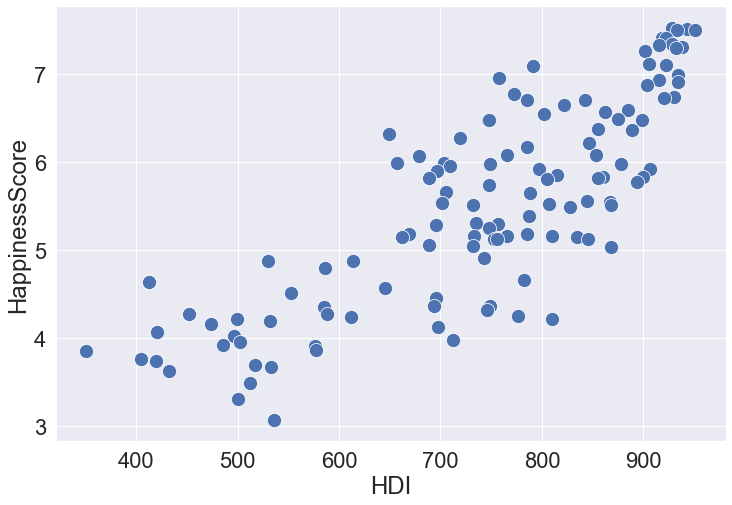

In [5]:
plt.figure(figsize=(12,8))
ax = sns.scatterplot(x="HDI", y="HappinessScore", data=data, s = 200)
sns.set(font_scale = 2)

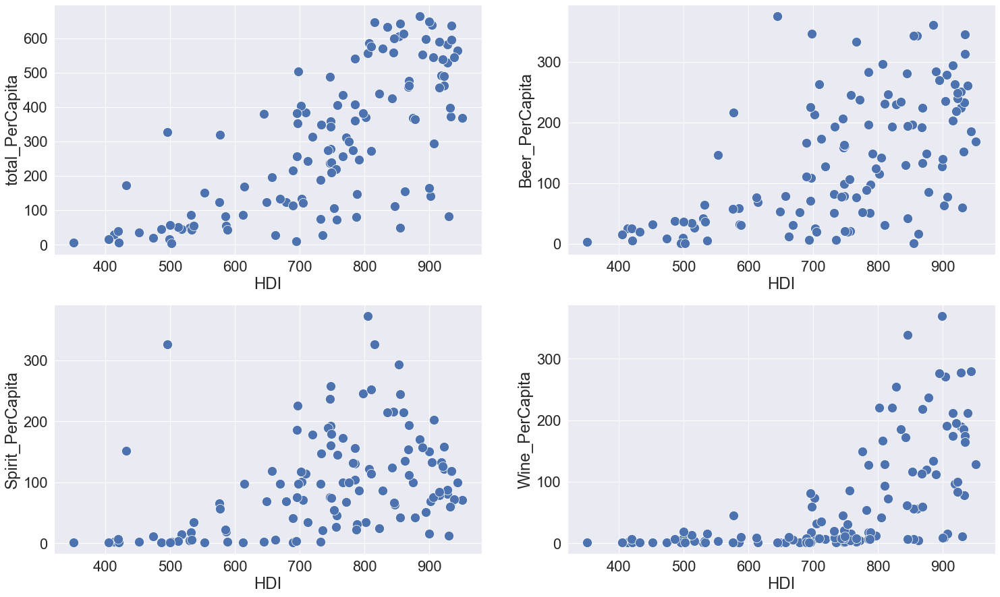

In [44]:
# define the plot size
plt.figure(figsize=(25,15))

# define a 2*2 subplot, put the plot on upper left position

plt.subplot(221)
ax = sns.scatterplot(x="HDI", y="total_PerCapita", data=data, s = 200)

plt.subplot(222)
ax = sns.scatterplot(x="HDI", y="Beer_PerCapita", data=data, s = 200)

plt.subplot(223)
sns.scatterplot(x="HDI", y="Spirit_PerCapita", data=data, s = 200)

plt.subplot(224)
ax = sns.scatterplot(x="HDI", y="Wine_PerCapita", data=data, s = 200)




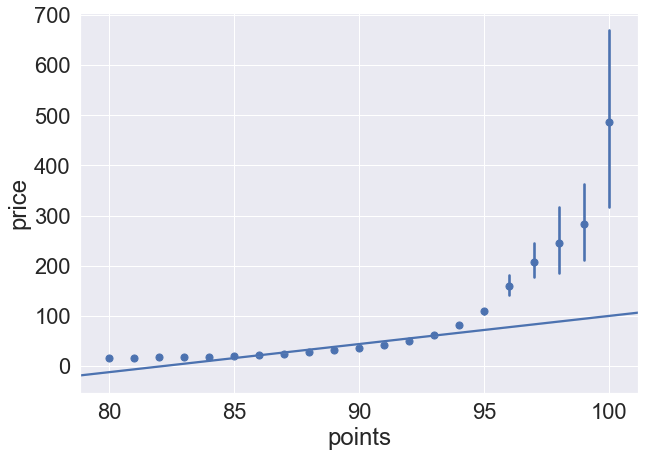

In [99]:
plt.figure(figsize=(10,7))
sns.regplot(x='points', y='price', x_estimator=np.mean, data=data1)

Top 5 most frequent type of grapes

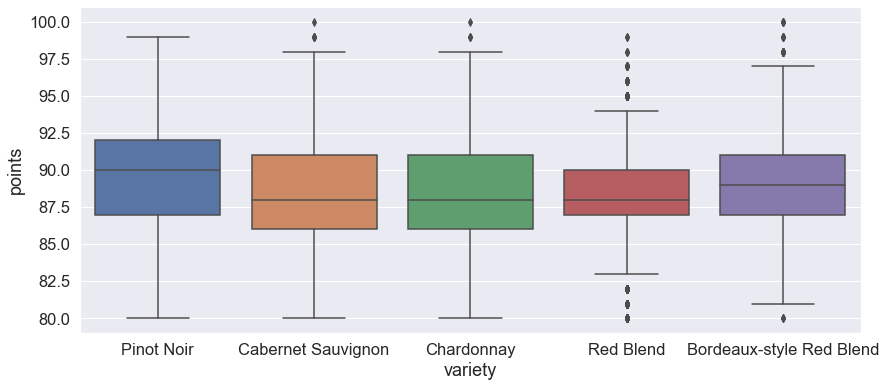

In [266]:
data1[data1["price"]>100]
df1= data1[data1.variety.isin(data1.variety.value_counts().head(5).index)]
plt.figure(figsize = (14,6))
sns.boxplot(
    x = 'variety',
    y = 'points',
    data = df1
)
sns.set(font_scale = 1)

In [387]:
# data1.variety.value_counts()

In [117]:
a=data1.groupby("country").mean()
# a
a.info()

<class 'pandas.core.frame.DataFrame'>
Index: 43 entries, Argentina to Uruguay
Data columns (total 2 columns):
points    43 non-null float64
price     42 non-null float64
dtypes: float64(2)
memory usage: 1.0+ KB


In [407]:
df = b[['country', 'winery','points','province']].groupby(["country","province"]).mean()
df

points
country   province                     
Argentina Mendoza Province    96.333333
Australia South Australia     96.647059
          Victoria            98.400000
Austria   Burgenland          96.700000
          Kamptal             96.000000
          Kremstal            96.000000
          Niederösterreich    96.000000
          Thermenregion       96.000000
          Wachau              96.000000
          Wagram              96.000000
France    Alsace              96.148148
          Bordeaux            96.808000
          Burgundy            96.492063
          Champagne           96.923077
          France Other        96.000000
          Loire Valley        97.666667
          Rhône Valley        96.750000
          Southwest France    96.000000
Germany   Franken             96.000000
          Mosel               96.142857
          Mosel-Saar-Ruwer    96.200000
          Pfalz               97.000000
          Rheingau            96.600000
          Rheinhessen         96.000000
Hungary   Tokaji              96.250000
Italy     Central Italy       96.000000
          Lombardy            96.000000
          Northeastern Italy  96.500000
          Piedmont            96.701754
          Sicily & Sardinia   97.000000
          Southern Italy      96.500000
          Tuscany             97.030769
          Veneto              96.000000
Portugal  Alentejo            96.500000
          Douro               97.111111
          Madeira             97.000000
          Port                96.730769
Spain     Andalucia           96.000000
          Catalonia           96.000000
          Levante             97.000000
          Northern Spain      96.352941
US        California          96.579545
          Oregon              96.400000
          Washington          96.596491

In [418]:
print(df.index)

Index(['Argentina', 'Armenia', 'Australia', 'Austria',
       'Bosnia and Herzegovina', 'Brazil', 'Bulgaria', 'Canada', 'Chile',
       'China', 'Croatia', 'Cyprus', 'Czech Republic', 'Egypt', 'England',
       'France', 'Georgia', 'Germany', 'Greece', 'Hungary', 'India', 'Israel',
       'Italy', 'Lebanon', 'Luxembourg', 'Macedonia', 'Mexico', 'Moldova',
       'Morocco', 'New Zealand', 'Peru', 'Portugal', 'Romania', 'Serbia',
       'Slovakia', 'Slovenia', 'South Africa', 'Spain', 'Switzerland',
       'Turkey', 'US', 'Ukraine', 'Uruguay'],
      dtype='object', name='country')


In [419]:
temp = data1
# b = data1[data1["points"]>95]
# b.groupby("winery").mean()
df = data1[['country', 'winery','price']].groupby(["country"]).mean()
df
df['code'] = ''
lst = []
for i in range(len(df)):
    if(df.index[i] == 'Argentina'):
        lst.append('ARG')
    if(df.index[i] == 'Armenia'):
        lst.append('ARM')
    if(df.index[i] == 'Australia'):
        lst.append('AUS')
    if(df.index[i] == 'Austria'):
        lst.append('AUT')
    if(df.index[i] == 'Bosnia and Herzegovina'):
        lst.append('BIH')       
    if(df.index[i] == 'Brazil'):
        lst.append('BRA')          
    if(df.index[i] == 'Bulgaria'):
        lst.append('BGR')    
    if(df.index[i] == 'Canada'):
        lst.append('CAN')  
    if(df.index[i] == 'Chile'):
        lst.append('CHL')     
    if(df.index[i] == 'China'):
        lst.append('CHN')  
    if(df.index[i] == 'Croatia'):
        lst.append('HRV')          
    if(df.index[i] == 'Cyprus'):
        lst.append('CYP')         
    if(df.index[i] == 'Czech Republic'):
        lst.append('CZE') 
    if(df.index[i] == 'Egypt'):
        lst.append('EGY') 
    if(df.index[i] == 'England'):
        lst.append('GBR')  
    if(df.index[i] == 'France'):
         lst.append('FRA')
    if(df.index[i] == 'Georgia'):
        lst.append('GEO')             
    if(df.index[i] == 'Germany'):
        lst.append('DEU')
    if(df.index[i] == 'Greece'):
        lst.append('GRC')        
    if(df.index[i] == 'Hungary'):
        lst.append('HUN')        
    if(df.index[i] == 'India'):
        lst.append('IND')    
    if(df.index[i] == 'Israel'):
        lst.append('ISR')              
    if(df.index[i] == 'Italy'):
        lst.append('ITA')
    if(df.index[i] == 'Lebanon'):
        lst.append('LBN')        
    if(df.index[i] == 'Luxembourg'):
        lst.append('LUX')          
    if(df.index[i] == 'Macedonia'):
        lst.append('MKD')          
    if(df.index[i] == 'Mexico'):
        lst.append('MEX')  
    if(df.index[i] == 'Moldova'):
        lst.append('MDA')  
    if(df.index[i] == 'Morocco'):
        lst.append('MAR') 
    if(df.index[i] == 'New Zealand'):
        lst.append('NZL') 
    if(df.index[i] == 'Peru'):
        lst.append('PER') 
    if(df.index[i] == 'Portugal'):
        lst.append('PRT')
    if(df.index[i] == 'Romania'):
        lst.append('ROU')
    if(df.index[i] == 'Serbia'):
        lst.append('SRB')
    if(df.index[i] == 'Slovakia'):
        lst.append('SVK')
    if(df.index[i] == 'Slovenia'):
        lst.append('SVN')
    if(df.index[i] == 'South Africa'):
        lst.append('ZAF')
    if(df.index[i] == 'Spain'):
        lst.append('ESP')
    if(df.index[i] == 'Switzerland'):
        lst.append('CHE')      
    if(df.index[i] == 'Turkey'):
        lst.append('TUR')  
    if(df.index[i] == 'US'):
        lst.append('USA')
    if(df.index[i] == 'Ukraine'):
        lst.append('UKR')          
    if(df.index[i] == 'Uruguay'):
        lst.append('URY')


df['code'] = lst
df

,price,code
country,,
Argentina,24.510117,ARG
Armenia,14.500000,ARM
Australia,35.437663,AUS
Austria,30.762772,AUT
Bosnia and Herzegovina,12.500000,BIH
Brazil,23.765957,BRA
Bulgaria,14.645390,BGR
Canada,35.712598,CAN
Chile,20.786458,CHL


In [436]:
import plotly.graph_objects as go
import pandas as pd


fig = go.Figure(data=go.Choropleth(
    locations = df['code'],
    z = df['price'],
    text = df.index,
    colorscale = 'Reds',
    autocolorscale=True,
    reversescale=True,
    marker_line_color='darkgray',
    marker_line_width=0.5,
    colorbar_title = 'price',
))

fig.update_layout(
    title_text='Average price for each country',
    geo=dict(
        showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'
    ),
)

fig.show()

In [370]:
data1.head()

,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery,haha
0,Italy,"Aromas include tropical fruit, broom, brimstone and dried herb. The palate isn't overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity.",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,None,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia,NaN
1,Portugal,"This is ripe and fruity, a wine that is smooth while still structured. Firm tannins are filled out with juicy red berry fruits and freshened with acidity. It's already drinkable, although it will certainly be better from 2016.",Avidagos,87,15.0,Douro,None,None,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos,NaN
2,US,"Tart and snappy, the flavors of lime flesh and rind dominate. Some green pineapple pokes through, with crisp acidity underscoring the flavors. The wine was all stainless-steel fermented.",None,87,14.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Rainstorm 2013 Pinot Gris (Willamette Valley),Pinot Gris,Rainstorm,NaN
3,US,"Pineapple rind, lemon pith and orange blossom start off the aromas. The palate is a bit more opulent, with notes of honey-drizzled guava and mango giving way to a slightly astringent, semidry finish.",Reserve Late Harvest,87,13.0,Michigan,Lake Michigan Shore,None,Alexander Peartree,None,St. Julian 2013 Reserve Late Harvest Riesling (Lake Michigan Shore),Riesling,St. Julian,NaN
4,US,"Much like the regular bottling from 2012, this comes across as rather rough and tannic, with rustic, earthy, herbal characteristics. Nonetheless, if you think of it as a pleasantly unfussy country wine, it's a good companion to a hearty winter stew.",Vintner's Reserve Wild Child Block,87,65.0,Oregon,Willamette Valley,Willamette Valley,Paul Gregutt,@paulgwine,Sweet Cheeks 2012 Vintner's Reserve Wild Child Block Pinot Noir (Willamette Valley),Pinot Noir,Sweet Cheeks,NaN


In [441]:
pd.set_option('display.max_colwidth', 1000)
row1 = b['description']
row1.count()

881

In [442]:
row1

345                                                                                                                                                                                                                                                                                                                                                                           This wine contains some material over 100 years old, but shows no signs of fragility. Instead, it's concentrated through age and should hold in the bottle indefinitely. It's dark coffee-brown in color, with delectable aromas of rancio, dried fig, molasses and black tea, yet despite enormous concentration avoids excessive weight. And it's amazingly complex and fresh on the nearly endless finish.
346                                                                                                                                                                                                                                         

In [450]:
import re
bb = re.compile("[a-zA-Z]+")
# (?<!\bon)(?<!\bare)(?<!\byears)(?<!\bs)(?<!\bits)\
# (?<!\bi)(?<!\bof)(?<!\bbut)(?<!\bfor)(?<!\ba)\
# (?<!\bto)(?<!\bthat)(?<!\bwith)(?<!\bis)(?<!\bthis)"
# use findall function find all values which match the pattern
name = bb.findall(str(row1))
#print name
newname = pd.DataFrame(name)
newname
# dups = newname.pivot_table(index=[0], aggfunc='size')
# dups.sort_values(ascending = False).head(30)



,0
0,T
1,h
2,i
3,s
4,w
5,i
6,n
7,e
8,c
9,o


In [453]:
aa = data1[data1['points']<85]
bbb = re.compile("\b(?!and|the)\b[a-zA-Z]+")
# use findall function find all values which match the pattern
name = bbb.findall(str(aa['description']))
#print name
newname = pd.DataFrame(name)
newname
# dups = newname.pivot_table(index=[0], aggfunc='size')
# dups.sort_values(ascending = False).head(30)



""
